In [3]:
import pandas as pd
import plotly.express as px
import nltk
import re
import matplotlib.pyplot as plt
import numpy as np

from nltk.corpus import stopwords
from nltk.stem import SnowballStemmer
from sklearn.model_selection import train_test_split

# Data Exploration

About Dataset
Context
This is the sentiment140 dataset. It contains 1,600,000 tweets extracted using the twitter api . The tweets have been annotated (0 = negative, 4 = positive) and they can be used to detect sentiment .

**Content**
It contains the following 6 fields:

- target: the polarity of the tweet (0 = negative, 2 = neutral, 4 = positive)

- ids: The id of the tweet ( 2087)

- date: the date of the tweet (Sat May 16 23:58:44 UTC 2009)

- flag: The query (lyx). If there is no query, then this value is NO_QUERY.

- user: the user that tweeted (robotickilldozr)

- text: the text of the tweet (Lyx is cool)

In [4]:
df = pd.read_csv("sentiment.csv",encoding = 'latin',header=None)
print(df.shape)
df.head()


(1600000, 6)


,0,1,2,3,4,5
0,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,0,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,0,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1600000 entries, 0 to 1599999
Data columns (total 6 columns):
 #   Column  Non-Null Count    Dtype 
---  ------  --------------    ----- 
 0   0       1600000 non-null  int64 
 1   1       1600000 non-null  int64 
 2   2       1600000 non-null  object
 3   3       1600000 non-null  object
 4   4       1600000 non-null  object
 5   5       1600000 non-null  object
dtypes: int64(2), object(4)
memory usage: 73.2+ MB


In [10]:
df.describe()

,0,1
count,1.600000e+06,1.600000e+06
mean,2.000000e+00,1.998818e+09
std,2.000001e+00,1.935761e+08
min,0.000000e+00,1.467810e+09
25%,0.000000e+00,1.956916e+09
50%,2.000000e+00,2.002102e+09
75%,4.000000e+00,2.177059e+09
max,4.000000e+00,2.329206e+09


We can see the columns are without any proper names. Lets rename them for our reference

In [5]:
df.columns = ['targets', 'ids', 'date', 'flag', 'user', 'text']
df.head()

,targets,ids,date,flag,user,text
0,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,0,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,0,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."


In [6]:
# Remplacer toutes les occurrences de 4 par 1 dans la colonne "targets"
df['targets'] = df['targets'].replace(4, 1)

In [7]:
positive_count = sum(df['targets'])
negative_count = len(df['targets']) - positive_count

percentage_positive = (positive_count / len(df['targets'])) * 100
percentage_negative = (negative_count / len(df['targets'])) * 100

print(f"Pourcentage de critiques positives : {percentage_positive:.2f}%")
print(f"Pourcentage de critiques négatives : {percentage_negative:.2f}%")
print(f"Nombre de critiques positives :" , positive_count)
print(f"Nombre de critiques négatives :" , negative_count)

Pourcentage de critiques positives : 50.00%
Pourcentage de critiques négatives : 50.00%
Nombre de critiques positives : 800000
Nombre de critiques négatives : 800000


In [8]:
# Create a histogram with two different colors for positive and negative classes
fig = px.histogram(df, x='targets', color='targets', title='Distribution of classes in train_labels', color_discrete_map={0: 'orange', 1: 'green'})

# Customize the x-axis labels
fig.update_xaxes(tickvals=[0, 1], ticktext=['Negative', 'Positive'])

# Show the histogram
fig.show()


# Data Preprocessing

In [9]:
# Vérifiez si les colonnes existent avant de les supprimer
columns_to_drop = ['ids', 'date', 'flag', 'user']

for col in columns_to_drop:
    assert col in df.columns, f"La colonne '{col}' n'existe pas dans le DataFrame."

# Supprimez les colonnes si elles existent
df.drop(columns_to_drop, axis=1, inplace=True)

# Affichez les premières lignes du DataFrame
df.head()


,targets,text
0,0,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,0,is upset that he can't update his Facebook by ...
2,0,@Kenichan I dived many times for the ball. Man...
3,0,my whole body feels itchy and like its on fire
4,0,"@nationwideclass no, it's not behaving at all...."


In [10]:
import random
random_idx_list = [random.randint(1,len(df.text)) for i in range(10)] # creates random indexes to choose from dataframe
df.loc[random_idx_list,:].head(10) 

,targets,text
957466,1,@mykelbonus: thanks!
341795,0,i just got a email that made me very sad it f...
159081,0,why do i try?? ouch
423681,0,@IvanaE i knw... he has his own song... so ma...
986912,1,@BigAlUK Could have been ED
1208937,1,"@HillarySaysHi Well go on, girl! Get back in t..."
1218273,1,@joe_wiley ei man is that your nissan
27455,0,Off to the Audubon Center and Sanctuary...walk...
554145,0,I'm missing out on the lakers parade
279677,0,"back to the daily grind, wants to swim with th..."


# Text Preprocessing

In [37]:
stop_words = set(stopwords.words('english'))
stemmer = SnowballStemmer('english')
text_cleaning_re = "@\S+|https?:\S+|http?:\S|[^A-Za-z0-9]+"

In [38]:
def preprocess(text, stem=False):
    text = re.sub(text_cleaning_re, ' ', str(text).lower()).strip()
    tokens = []
    for token in text.split():
        if token not in stop_words:
            if stem:
                tokens.append(stemmer.stem(token))
            else:
                tokens.append(token)
    return " ".join(tokens)

Lemmatization and stemming are two text normalization techniques used in natural language processing (NLP) to reduce words to their base or truncated form.

The choice between lemmatization and rootization depends on the specific needs of your NLP application. If accuracy and semantic understanding are important, lemmatization is often preferred. If processing speed is a key factor, rooting may be more appropriate.  

I wanted to try lemmatization first but the code takes an extremely long time to run, this is explained by the large size of the dataset. We therefore opted for a stemmer technique.



In [39]:
print("Text before preprocessing : ", df['text'][0])
df['text'] = df['text'].apply(preprocess)
print("Text after preprocessing : ", df['text'][0])

Text before preprocessing :  @switchfoot http://twitpic.com/2y1zl - Awww, that's a bummer.  You shoulda got David Carr of Third Day to do it. ;D
Text after preprocessing :  awww bummer shoulda got david carr third day


In [40]:
lab_to_sentiment = {0:"Negative", 1:"Positive"}
def label_decoder(label):
  return lab_to_sentiment[label]
df['targets'] = df['targets'].apply(lambda x: label_decoder(x))
df.head()

,targets,text
0,Negative,awww bummer shoulda got david carr third day
1,Negative,upset update facebook texting might cry result...
2,Negative,dived many times ball managed save 50 rest go ...
3,Negative,whole body feels itchy like fire
4,Negative,behaving mad see


### Positive words

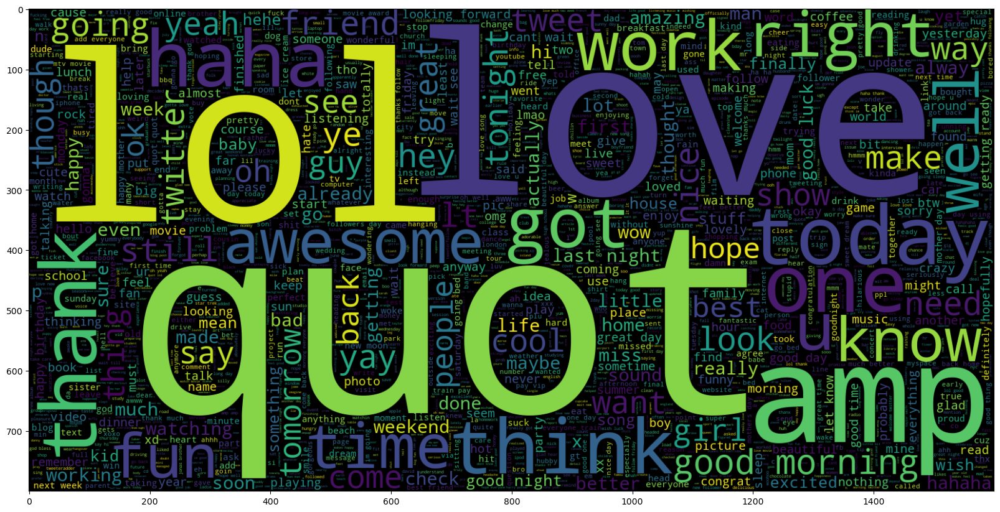

In [41]:
from wordcloud import WordCloud

plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800).generate(" ".join(df[df["targets"] == 'Positive'].text))
plt.imshow(wc , interpolation = 'bilinear')

### Negative words

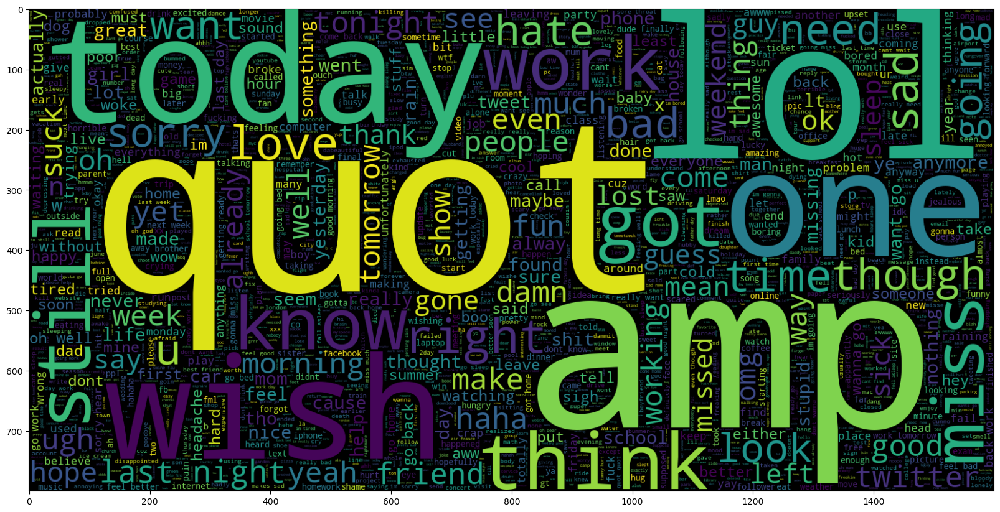

In [42]:
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800).generate(" ".join(df[df["targets"] == 'Negative'].text))
plt.imshow(wc , interpolation = 'bilinear')

### Train Test Split

In [43]:
# Split your DataFrame into features (X) and target (y)
X = df['text']  
y = df['targets'] 

# Split the data into training and testing sets (e.g., 80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("Train Data shape:", X_train.shape)
print("Test Data shape", X_test.shape)

Train Data shape: (1280000,)
Test Data shape (320000,)


In [44]:
X_train.head()

1374558    ya quot like palm pre touchstone charger ready...
1389115            felt earthquake afternoon seems epicenter
1137831                            ruffles shirts like likey
790714     pretty bad night crappy morning fml buttface d...
1117911                                      yeah clear view
Name: text, dtype: object

# Model Definition

In [45]:
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.naive_bayes import MultinomialNB

text_clf = Pipeline([
    ('count_vectorizer', CountVectorizer(preprocessor=preprocess)),
    ('classifier', MultinomialNB())
])

## Training

In [46]:
# fit the pipeline to the training data 
text_clf.fit(X_train, y_train)

Pipeline(steps=[('count_vectorizer',
                 CountVectorizer(preprocessor=<function preprocess at 0x00000212BBF7A560>)),
                ('classifier', MultinomialNB())])

## Prediction

In [47]:
y_pred = text_clf.predict(X_test)# Use the pipeline to run predictions on the test data
y_pred

array(['Positive', 'Positive', 'Positive', ..., 'Positive', 'Negative',
       'Negative'], dtype='<U8')

## Resultats visualization

In [48]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score
class_labels = ["Negative","Positive"]

# Styling the confusion matrix
confusion_matrix_kwargs = dict(
    text_auto=True,
    title="Confusion Matrix", width=1000, height=800,
    labels=dict(x="Predicted", y="True Label"),
    x=class_labels,
    y=class_labels,
    color_continuous_scale='Blues'
)

 
def report(y_true, y_pred, class_labels):
    print(classification_report(y_true, y_pred, target_names=class_labels))
    # Create a confusion matrix
    confusion_matrix = pd.crosstab(y_true, y_pred, rownames=['Actual'], colnames=['Predicted'])
    # Style and display the confusion matrix
    fig = px.imshow(
        confusion_matrix,
        **confusion_matrix_kwargs
    )
    fig.show()
    

In [49]:
# call the report function to visualize the classification results, use the above class_labels
report(y_test,y_pred, class_labels)

              precision    recall  f1-score   support

    Negative       0.76      0.79      0.77    159494
    Positive       0.78      0.75      0.76    160506

    accuracy                           0.77    320000
   macro avg       0.77      0.77      0.77    320000
weighted avg       0.77      0.77      0.77    320000



# Improve on the baseline

## Let's try with TD-IDF

In [50]:
class Model:
    def __init__(self, X, y, model_architecture, vectorizer, random_seed=42, test_size=0.2) -> None:
        self.X = X
        self.y = y
        self.model_instance = model_architecture
        self.vectorizer = vectorizer
        self.random_seed = random_seed
        self.test_size = test_size

        # Create the pipeline
        self.pipeline = Pipeline([
            ('vectorizer', self.vectorizer),
            ('model', self.model_instance)
        ])

        # Split the data into training and testing sets
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(
            self.X, self.y, test_size=self.test_size, random_state=self.random_seed)

    def preprocess(text, stem=False):
        text = re.sub(text_cleaning_re, ' ', str(text).lower()).strip()
        tokens = []
        for token in text.split():
            if token not in stop_words:
                if stem:
                    tokens.append(stemmer.stem(token))
                else:
                    tokens.append(token)
        return " ".join(tokens)
    
    def fit(self):
        # Fit the pipeline to the training data
        self.pipeline.fit(self.X_train, self.y_train)

    def predict(self):
        # Predict on the test data
        return self.pipeline.predict(self.X_test)

    def predict_proba(self):
        # Predict probabilities on the test data
        return self.pipeline.predict_proba(self.X_test)

    def report(self, y_true, y_pred, class_labels):
        # Print classification report
        print(classification_report(y_true, y_pred, target_names=class_labels))

        # Create a confusion matrix
        confusion_matrix_df = pd.crosstab(y_true, y_pred, rownames=['Actual'], colnames=['Predicted'])

        # Styling the confusion matrix
        confusion_matrix_kwargs = dict(
            text_auto=True, 
            title="Confusion Matrix", width=1000, height=800,
            labels=dict(x="Predicted", y="True Label"),
            x=class_labels,
            y=class_labels,
            color_continuous_scale='Blues'
        )

        # Display the confusion matrix
        fig = px.imshow(
            confusion_matrix_df, 
            **confusion_matrix_kwargs
        )
        fig.show()


In [51]:
# Instantiate and fit the Multinomial Naive Bayes model
nb_model = Model(X, y, MultinomialNB(), TfidfVectorizer(preprocessor=preprocess))
nb_model.fit()

# Predict on the test data
y_nb_pred = nb_model.predict()


# Generate a classification report
nb_model.report(nb_model.y_test, y_nb_pred, class_labels)

              precision    recall  f1-score   support

    Negative       0.75      0.78      0.77    159494
    Positive       0.77      0.75      0.76    160506

    accuracy                           0.76    320000
   macro avg       0.76      0.76      0.76    320000
weighted avg       0.76      0.76      0.76    320000



In [52]:
from sklearn.linear_model import LogisticRegression


model = Model(X, y, LogisticRegression(), CountVectorizer(preprocessor=preprocess))

# Fit the model
model.fit()

# Predict on the test data
y_pred = model.predict()


# Generate a classification report
model.report(model.y_test, y_pred, class_labels)

c:\Users\Minh-Tan\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



              precision    recall  f1-score   support

    Negative       0.79      0.75      0.77    159494
    Positive       0.76      0.80      0.78    160506

    accuracy                           0.78    320000
   macro avg       0.78      0.78      0.78    320000
weighted avg       0.78      0.78      0.78    320000



In [53]:
from sklearn.model_selection import GridSearchCV

# Divisez vos données en un échantillon équilibré
X_train, X_sample, y_train, y_sample = train_test_split(X, y, test_size=0.1, stratify=y, random_state=42)
#X_sample et y_sample ont une taille de 8500 éléments


# Définissez les hyperparamètres à rechercher pour le CountVectorizer
param_grid_cv = {
    'count_vectorizer__max_features': [1000, 5000, 10000, None],
    'count_vectorizer__ngram_range': [(1, 1), (1, 2)],
}

# Définissez les hyperparamètres à rechercher pour la régression logistique
param_grid_lr = {
    'classifier__C': [0.001, 0.01, 0.1, 1, 10],
    'classifier__max_iter': [100, 200, 300],
}

# Créez le pipeline avec le CountVectorizer et la régression logistique
text_clf = Pipeline([
    ('count_vectorizer', CountVectorizer(preprocessor=preprocess)),
    ('classifier', LogisticRegression())
])

# Effectuez la recherche en grille avec validation croisée sur vos données
grid_search_cv = GridSearchCV(text_clf, param_grid_cv, cv=5, scoring='accuracy')
grid_search_lr = GridSearchCV(text_clf, param_grid_lr, cv=5, scoring='accuracy')

# Fit the models
grid_search_cv.fit(X_sample, y_sample)
grid_search_lr.fit(X_sample, y_sample)

# Obtenez les meilleurs hyperparamètres et le meilleur score pour le CountVectorizer
best_params_cv = grid_search_cv.best_params_
best_score_cv = grid_search_cv.best_score_

# Obtenez les meilleurs hyperparamètres et le meilleur score pour la régression logistique
best_params_lr = grid_search_lr.best_params_
best_score_lr = grid_search_lr.best_score_

print("Meilleurs hyperparamètres pour CountVectorizer :")
print(best_params_cv)
print("Meilleur score pour CountVectorizer :")
print(best_score_cv)

print("Meilleurs hyperparamètres pour la régression logistique :")
print(best_params_lr)
print("Meilleur score pour la régression logistique :")
print(best_score_lr)


c:\Users\Minh-Tan\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

c:\Users\Minh-Tan\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

c:\Users\Minh-Tan\anaconda3\lib\site

Meilleurs hyperparamètres pour CountVectorizer :
{'count_vectorizer__max_features': None, 'count_vectorizer__ngram_range': (1, 2)}
Meilleur score pour CountVectorizer :
0.7688312500000001
Meilleurs hyperparamètres pour la régression logistique :
{'classifier__C': 0.1, 'classifier__max_iter': 100}
Meilleur score pour la régression logistique :
0.7617375


c:\Users\Minh-Tan\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [54]:
from sklearn.linear_model import LogisticRegression


model = Model(X, y, LogisticRegression(C=best_params_lr['classifier__C'], max_iter=best_params_lr['classifier__max_iter']), 
              CountVectorizer(preprocessor=preprocess, max_features=best_params_cv['count_vectorizer__max_features'], ngram_range=best_params_cv['count_vectorizer__ngram_range']))

# Fit the model
model.fit()

# Predict on the test data
y_pred = model.predict()


# Generate a classification report
model.report(model.y_test, y_pred, class_labels)

c:\Users\Minh-Tan\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



              precision    recall  f1-score   support

    Negative       0.81      0.76      0.78    159494
    Positive       0.77      0.82      0.80    160506

    accuracy                           0.79    320000
   macro avg       0.79      0.79      0.79    320000
weighted avg       0.79      0.79      0.79    320000



# Use Tensorflow (or PyTorch, JAX, ...) and train a sequence model of your choice (RNN, GRU, LSTM, Transformer, ...)

## Tokenization

In [1]:
MAX_NB_WORDS = 100000
MAX_SEQUENCE_LENGTH = 30

In [12]:
train_data, test_data = train_test_split(df, test_size=0.2, random_state=42)

from keras.preprocessing.text import Tokenizer

tokenizer = Tokenizer()
tokenizer.fit_on_texts(train_data["text"])

word_index = tokenizer.word_index
vocab_size = len(tokenizer.word_index) + 1
print("Vocabulary Size :", vocab_size)

Vocabulary Size : 594849


In [13]:
from keras.preprocessing.sequence import pad_sequences

x_train = pad_sequences(tokenizer.texts_to_sequences(train_data.text),
                        maxlen = MAX_SEQUENCE_LENGTH)
x_test = pad_sequences(tokenizer.texts_to_sequences(test_data.text),
                       maxlen = MAX_SEQUENCE_LENGTH)

print("Training X Shape:",x_train.shape)
print("Testing X Shape:",x_test.shape)

Training X Shape: (1280000, 30)
Testing X Shape: (320000, 30)


In [14]:
labels = train_data["targets"].unique().tolist()

## Label Encoding

In [15]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
encoder.fit(train_data["targets"].to_list())

y_train = encoder.transform(train_data["targets"].to_list())
y_test = encoder.transform(test_data["targets"].to_list())

y_train = y_train.reshape(-1,1)
y_test = y_test.reshape(-1,1)

print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)

y_train shape: (1280000, 1)
y_test shape: (320000, 1)


##  Word Embedding

In [31]:
import pickle

word_embeddings = pickle.load(open("word_embeddings_subset.p", "rb"))
len(word_embeddings)

243

In [16]:
EMBEDDING_DIM = 5
LR = 1e-3
BATCH_SIZE = 10240
EPOCHS = 3

# LTSM

In [17]:
embeddings_index = {}

embedding_matrix = np.zeros((vocab_size, EMBEDDING_DIM))
for word, i in word_index.items():
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
      embedding_matrix[i] = embedding_vector

In [18]:
import tensorflow as tf

embedding_layer = tf.keras.layers.Embedding(vocab_size,
                                          EMBEDDING_DIM,
                                          weights=[embedding_matrix],
                                          input_length=MAX_SEQUENCE_LENGTH,
                                          trainable=False)


In [19]:
from tensorflow.keras.layers import Conv1D, Bidirectional, LSTM, Dense, Input, Dropout
from tensorflow.keras.layers import SpatialDropout1D
from tensorflow.keras.callbacks import ModelCheckpoint

In [20]:
sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
embedding_sequences = embedding_layer(sequence_input)
x = SpatialDropout1D(0.2)(embedding_sequences)
x = Conv1D(64, 5, activation='relu')(x)
x = Bidirectional(LSTM(64, dropout=0.2, recurrent_dropout=0.2))(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
outputs = Dense(1, activation='sigmoid')(x)
model = tf.keras.Model(sequence_input, outputs)

In [21]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau

model.compile(optimizer=Adam(learning_rate=LR), loss='binary_crossentropy',
              metrics=['accuracy'])
ReduceLROnPlateau = ReduceLROnPlateau(factor=0.1,
                                     min_lr = 0.01,
                                     monitor = 'val_loss',
                                     verbose = 1)

In [22]:
print("Training on GPU...") if tf.test.is_gpu_available() else print("Training on CPU...")

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.
Training on CPU...


In [23]:
from tensorflow import keras

model = keras.Sequential()
model.add(keras.layers.Embedding(vocab_size, EMBEDDING_DIM, input_length=MAX_SEQUENCE_LENGTH))
model.add(keras.layers.LSTM(64))
model.add(keras.layers.Dense(1, activation='sigmoid'))


In [24]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])


In [25]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())


[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 16573751663866623916
xla_global_id: -1
]


In [29]:
# Utilisez un échantillon plus petit pour l'entraînement initial
x_train_subset, y_train_subset = x_train[:10000], y_train[:10000]

# Entraînez le modèle sur l'échantillon réduit
history = model.fit(x_train_subset, y_train_subset, batch_size=BATCH_SIZE, epochs=EPOCHS, validation_data=(x_test, y_test))


Epoch 1/3
1/1 [==============================] - 24s 24s/step - loss: 0.6932 - accuracy: 0.4834 - val_loss: 0.6932 - val_accuracy: 0.4984
Epoch 2/3
1/1 [==============================] - 19s 19s/step - loss: 0.6931 - accuracy: 0.5040 - val_loss: 0.6932 - val_accuracy: 0.4984
Epoch 3/3
1/1 [==============================] - 21s 21s/step - loss: 0.6930 - accuracy: 0.5040 - val_loss: 0.6931 - val_accuracy: 0.4984


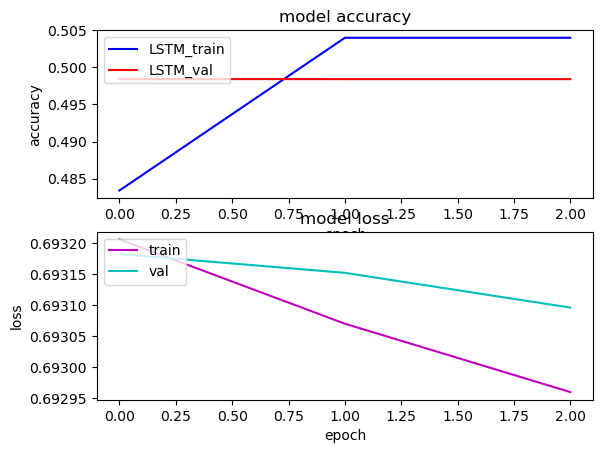

In [30]:
s, (at, al) = plt.subplots(2,1)
at.plot(history.history['accuracy'], c= 'b')
at.plot(history.history['val_accuracy'], c='r')
at.set_title('model accuracy')
at.set_ylabel('accuracy')
at.set_xlabel('epoch')
at.legend(['LSTM_train', 'LSTM_val'], loc='upper left')

al.plot(history.history['loss'], c='m')
al.plot(history.history['val_loss'], c='c')
al.set_title('model loss')
al.set_ylabel('loss')
al.set_xlabel('epoch')
al.legend(['train', 'val'], loc = 'upper left')

In [31]:
def decode_sentiment(score):
    return "Positive" if score>0.5 else "Negative"


scores = model.predict(x_test, verbose=1, batch_size=10000)
y_pred_1d = [decode_sentiment(score) for score in scores]

32/32 [==============================] - 17s 531ms/step
